In [201]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from scipy.spatial import KDTree
import requests
from prophet import Prophet
import folium
from folium.plugins import HeatMapWithTime
import sys
from tqdm import tqdm
import plotly.express as px
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
sys.path.append('/home/dimia/code/elpbcn/air-pollution-levels')
from airpollutionlevels.config import resolve_path

# Data import 

In [2]:
def data_prep_timeseries():
    '''
    Load the Pollution data for the Prophet model  .
    Prepare the data for the Prophet model.
    Remove the columns that are not needed.
    Remove Outliers.
    Save the data in a new csv file.

    '''
    data = pd.read_csv(resolve_path('airpollutionlevels/raw_data/monthly_pollution_europe.csv'))

    # Convert PM2.5 from kg/m³ to mg/m³
    data['pm2p5'] = data['pm2p5'] * 1e9

    # Convert 'time' column to datetime format and extract date
    data['date'] = pd.to_datetime(data['time']).dt.date

    # Drop unnecessary columns
    data = data.drop(['year', 'month', 'time' , 'pm10'], axis=1)

    # Define your threshold for outliers and African Countries
    threshold = 200
    lat_min, lat_max = 20, 37
    lon_min, lon_max = -10, 30

    # Remove outliers
    cleaned_data = data[data['pm2p5'] <= threshold]

    # Filter out North African data points
    cleaned_data = cleaned_data[~((cleaned_data['latitude'] >= lat_min) & (cleaned_data['latitude'] <= lat_max) &
                              (cleaned_data['longitude'] >= lon_min) & (cleaned_data['longitude'] <= lon_max))]

    # Prepare and sort by date
    cleaned_data = cleaned_data.set_index('date')
    cleaned_data.index = pd.to_datetime(cleaned_data.index)
    cleaned_data.sort_values('date', inplace=True)
    cleaned_data.reset_index(inplace=True)

    # Rename columns to match Prophet requirements
    cleaned_data = cleaned_data.rename(columns={'date': 'ds', 'pm2p5': 'y'})

    # Ensure "ds" is in datetime format
    cleaned_data['ds'] = pd.to_datetime(cleaned_data['ds'], errors='coerce')

    # Save the cleaned data
    cleaned_data.to_csv(resolve_path('airpollutionlevels/raw_data/cleaned_europe_data.csv'), index=False)


In [3]:
data_prep_timeseries()

In [4]:
data = pd.read_csv(resolve_path('airpollutionlevels/raw_data/cleaned_europe_data.csv'), parse_dates=['ds'])

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 659730 entries, 0 to 659729
Data columns (total 4 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   ds         659730 non-null  datetime64[ns]
 1   latitude   659730 non-null  float64       
 2   longitude  659730 non-null  float64       
 3   y          659730 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 20.1 MB


In [6]:
data.head()

,ds,latitude,longitude,y
0,2010-01-16,69.50,38.75,4.133660
1,2010-01-16,58.25,31.25,4.042675
2,2010-01-16,58.25,32.00,3.517962
3,2010-01-16,58.25,32.75,3.337757
4,2010-01-16,58.25,33.50,3.268414


# Model Functions 

In [7]:
def get_coordinates_opendatasoft(city_name, country_name):
    '''
    Get the coordinates of a city using the OpenDataSoft API.
    Parameters:
    city_name (str): The name of the city.
    country_name (str): The name of the country.
    returns: Tuple of floats (latitude, longitude) or (None, None) if no results are found.
    '''

    base_url = "https://public.opendatasoft.com/api/records/1.0/search/"
    params = {
        'dataset': 'geonames-all-cities-with-a-population-500',
        'q': f'{city_name}, {country_name}',
        'format': 'json'
    }
    response = requests.get(base_url, params=params)

    if response.status_code == 200:
        data = response.json()
        if data['nhits'] > 0:
            record = data['records'][0]['fields']
            lat = float(record['latitude'])
            lon = float(record['longitude'])
            return round(lat, 2), round(lon, 2)
        else:
            print(f"No results found for {city_name}, {country_name}")
            return None, None
    else:
        print(f"Failed to get coordinates for {city_name}, {country_name}. Response code: {response.status_code}")
        return None, None

In [8]:
def find_nearest_coordinates(target_lat, target_lon, dataset):
    '''
    Find the nearest coordinates to the target coordinates in the dataset.
    Parameters: target_lat (float): The target latitude.
                target_lon (float): The target longitude.
                dataset (DataFrame): The dataset containing the coordinates.
    Returns: Tuple of floats (nearest_lat, nearest_lon) of the nearest coordinates in the dataset.
    '''

    # Create a KDTree with dataset coordinates
    tree = KDTree(dataset[['latitude', 'longitude']])

    # Query the KDTree for nearest neighbor to the target coordinates
    dist, idx = tree.query([(target_lat, target_lon)])

    # Get the nearest coordinates from the dataset
    nearest_lat = dataset.iloc[idx[0]]['latitude']
    nearest_lon = dataset.iloc[idx[0]]['longitude']

    return nearest_lat, nearest_lon

In [277]:
def forecast_pm25(city_name, country_name, future_periods):
    '''
    Forecast PM2.5 levels for a city using the Prophet model.
    Parameters: city_name (str): The name of the city.
                country_name (str): The name of the country.
                future_periods (int): The number of future months to forecast.
    '''

    # Load the cleaned data
    dataset = pd.read_csv(resolve_path('airpollutionlevels/raw_data/cleaned_europe_data.csv'), parse_dates=['ds'])

    # Get city coordinates
    city_latitude, city_longitude = get_coordinates_opendatasoft(city_name, country_name)
    if city_latitude is None or city_longitude is None:
        print(f"Could not find coordinates for {city_name}, {country_name}.")
        return

    # Find nearest coordinates in the dataset
    nearest_lat, nearest_lon = find_nearest_coordinates(city_latitude, city_longitude, dataset)

    # Filter the dataset for the nearest coordinates
    city_data = dataset[(dataset['latitude'] == nearest_lat) & (dataset['longitude'] == nearest_lon)]
    city_data = city_data.reset_index(drop=True)

    # Ensure city_data 'ds' is in the correct format
    city_data['ds'] = pd.to_datetime(city_data['ds']).dt.tz_localize(None)

    if city_data.empty:
        print(f"No data available for the nearest coordinates to {city_name}, {country_name}.")
        return

    # Prepare training data
    train_data = city_data[['ds', 'y', 'latitude', 'longitude']]

    # Initialize and train Prophet model with best parameters
    best_params = {'changepoint_prior_scale': 0.01, 'holidays_prior_scale': 1.0, 'interval_width': 0.5, 'seasonality_mode': 'multiplicative', 'seasonality_prior_scale': 10.0}
    model = Prophet(**best_params)
    model.add_regressor('latitude')
    model.add_regressor('longitude')
    model.fit(train_data)

    # Forecast future PM2.5 levels
    future_dates = model.make_future_dataframe(periods=future_periods, freq='M')
    future_dates['latitude'] = nearest_lat
    future_dates['longitude'] = nearest_lon
    forecast = model.predict(future_dates)

    # Ensure forecast 'ds' is in the correct format
    forecast['ds'] = pd.to_datetime(forecast['ds']).dt.tz_localize(None)

    # Extract the trend component
    trend = forecast[['ds', 'trend']]

    # Calculate mean of yhat_lower and yhat_upper for the forecast period
    mean_yhat_lower = forecast['yhat_lower'].mean()
    mean_yhat_upper = forecast['yhat_upper'].mean()

    # Add text description
    text_description = f"For the next {future_periods} months, the PM2.5 levels are forecasted to be between {mean_yhat_lower:.2f} and {mean_yhat_upper:.2f} µg/m³ on average."

    # Plot the forecast and actual values
    plt.figure(figsize=(14, 6))
    plt.text(0.5, 1.1, text_description, ha='center', va='center', transform=plt.gca().transAxes, fontsize=12, bbox=dict(facecolor='lightgrey', alpha=0.5))
    plt.plot(city_data['ds'], city_data['y'], label='Actual', color='blue')
    plt.plot(forecast['ds'], forecast['yhat'], label='Forecast', linestyle='--', color='red')
    plt.fill_between(forecast['ds'], forecast['yhat_lower'], forecast['yhat_upper'], label='Uncertainty Range', color='lightgreen', alpha=0.3)
    plt.xlabel('Date')
    plt.ylabel('PM2.5 (µg/m³)')
    plt.title(f'Actual vs. Forecasted PM2.5 Levels for {city_name}, {country_name}')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Plot the trend component
    plt.figure(figsize=(14, 6))
    plt.plot(trend['ds'], trend['trend'], label='Trend', color='lightblue')
    plt.xlabel('Date')
    plt.ylabel('Trend Value')
    plt.title(f'Trend of PM2.5 Levels for {city_name}, {country_name}')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Add latitude and longitude columns to forecast DataFrame
    forecast['latitude'] = nearest_lat
    forecast['longitude'] = nearest_lon

    # Return forecast DataFrame
    #return forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper', 'latitude', 'longitude']].tail(future_periods) # no need at the moment


15:33:55 - cmdstanpy - INFO - Chain [1] start processing
15:33:55 - cmdstanpy - INFO - Chain [1] done processing


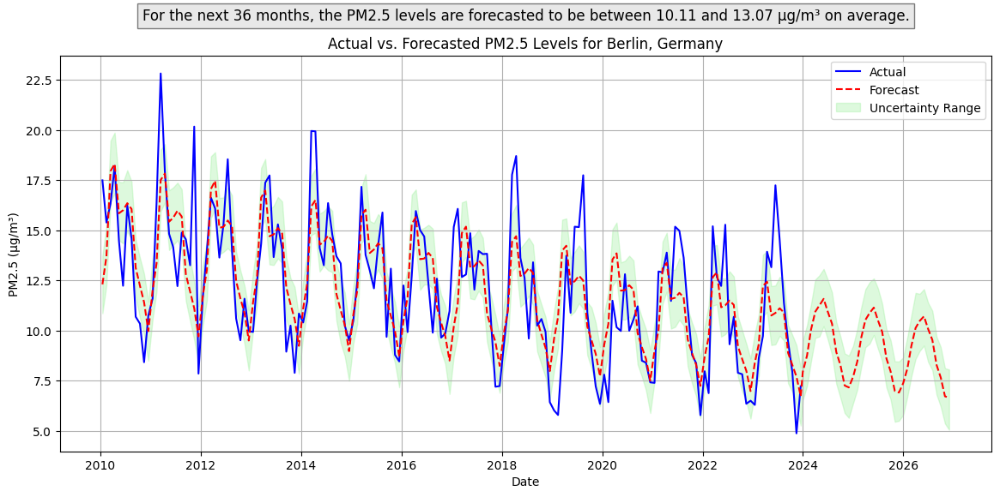

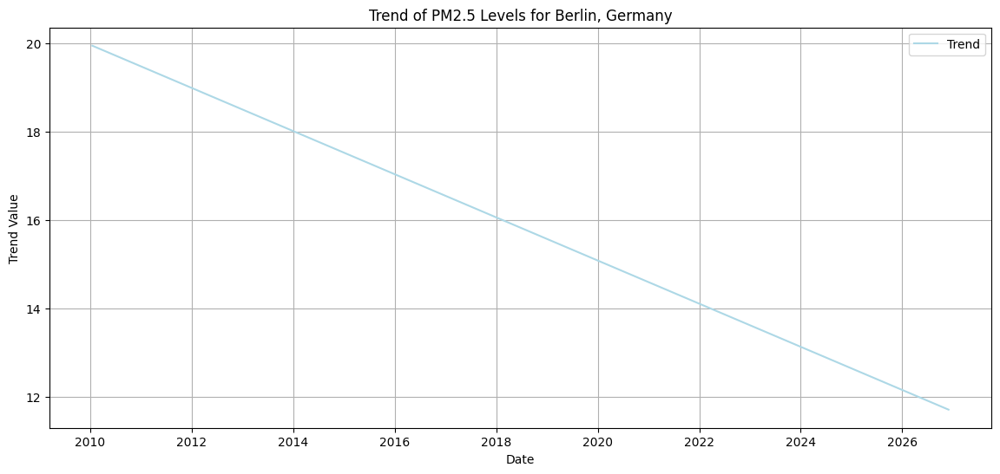

In [278]:
city_name = 'Berlin'
country_name = 'Germany'
future_periods = 36  # Forecast for the next X months

forecast = forecast_pm25(city_name, country_name, future_periods)

In [169]:
forecast

,ds,yhat,yhat_lower,yhat_upper,latitude,longitude
168,2023-12-31,14.332284,12.267913,16.731026,45.5,9.5
169,2024-01-31,15.697685,13.408542,18.040112,45.5,9.5
170,2024-02-29,14.990332,12.436289,17.343682,45.5,9.5
171,2024-03-31,15.094175,12.496128,17.554606,45.5,9.5
172,2024-04-30,13.263941,10.917830,15.661190,45.5,9.5
173,2024-05-31,12.124911,10.023745,14.810249,45.5,9.5
174,2024-06-30,10.633363,8.007591,12.857871,45.5,9.5
175,2024-07-31,10.263508,7.644972,12.522577,45.5,9.5
176,2024-08-31,9.603846,7.386479,12.089395,45.5,9.5
177,2024-09-30,10.279288,7.920254,12.485786,45.5,9.5


# Map exploring

In [200]:
from tqdm import tqdm
def forecast_pm25_all_coords(dataset, future_periods=120):
    '''
    Forecast PM2.5 levels for each unique coordinate set in the dataset using the Prophet model.
    Parameters:
        dataset (DataFrame): The dataset containing 'ds' (date), 'latitude', 'longitude', and 'y' (PM2.5 levels).
        future_periods (int): The number of future months to forecast (default is 120 for 10 years).
    Returns:
        all_forecasts (DataFrame): Forecasted data including 'ds' (date), 'yhat' (predicted PM2.5 levels),
                                   'yhat_lower' (lower bound of predicted PM2.5 levels),
                                   'yhat_upper' (upper bound of predicted PM2.5 levels),
                                   'latitude', 'longitude'.
        metrics_df (DataFrame): Metrics for each coordinate including 'latitude', 'longitude', 'MAE', 'MSE', 'RMSE', 'R2'.
    '''
    all_forecasts = pd.DataFrame()
    metrics_list = []

    # Get unique coordinate sets
    unique_coords = dataset[['latitude', 'longitude']].drop_duplicates()

    # Initialize tqdm with total number of iterations
    pbar = tqdm(total=len(unique_coords), desc="Forecasting PM2.5")

    # Iterate over unique coordinate sets
    for index, row in unique_coords.iterrows():
        city_latitude, city_longitude = row['latitude'], row['longitude']

        # Filter the dataset for the current coordinates
        city_data = dataset[(dataset['latitude'] == city_latitude) & (dataset['longitude'] == city_longitude)]
        city_data = city_data.reset_index(drop=True)

        # Ensure city_data 'ds' is in the correct format
        city_data['ds'] = pd.to_datetime(city_data['ds']).dt.tz_localize(None)

        if city_data.empty:
            print(f"No data available for coordinates: ({city_latitude}, {city_longitude})")
            continue

        # Prepare training data
        train_data = city_data[['ds', 'y', 'latitude', 'longitude']]

        # Initialize and train Prophet model with best parameters
        best_params = {
            'changepoint_prior_scale': 0.01,
            'holidays_prior_scale': 1.0,
            'interval_width': 0.5,
            'seasonality_mode': 'multiplicative',
            'seasonality_prior_scale': 10.0
        }
        model = Prophet(**best_params)
        model.add_regressor('latitude')
        model.add_regressor('longitude')
        model.fit(train_data)

        # Forecast future PM2.5 levels
        future_dates = model.make_future_dataframe(periods=future_periods, freq='M')
        future_dates['latitude'] = city_latitude
        future_dates['longitude'] = city_longitude
        forecast = model.predict(future_dates)

        # Ensure forecast 'ds' is in the correct format
        forecast['ds'] = pd.to_datetime(forecast['ds']).dt.tz_localize(None)

        # Add latitude and longitude columns to forecast DataFrame
        forecast['latitude'] = city_latitude
        forecast['longitude'] = city_longitude

        # Calculate metrics for the current coordinates
        y_true = city_data['y']
        y_pred = forecast.loc[forecast['ds'].isin(city_data['ds']), 'yhat']
        mae = mean_absolute_error(y_true, y_pred)
        mse = mean_squared_error(y_true, y_pred)
        rmse = mse ** 0.5
        r2 = r2_score(y_true, y_pred)

        metrics_list.append({
            'latitude': city_latitude,
            'longitude': city_longitude,
            'MAE': mae,
            'MSE': mse,
            'RMSE': rmse,
            'R2': r2
        })

        # Append forecast to all_forecasts DataFrame
        all_forecasts = pd.concat([all_forecasts, forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper', 'latitude', 'longitude']]], ignore_index=True)

        # Update tqdm progress bar
        pbar.update(1)

    # Close tqdm progress bar
    pbar.close()

    # Convert metrics list to DataFrame
    metrics_df = pd.DataFrame(metrics_list)

    return all_forecasts, metrics_df

In [203]:

future_periods = 120  # 10 years (12 months per year)
forecasts, metrics = forecast_pm25_all_coords(data, future_periods)

Forecasting PM2.5:   0%|          | 0/3927 [00:00<?, ?it/s]14:35:28 - cmdstanpy - INFO - Chain [1] start processing
14:35:28 - cmdstanpy - INFO - Chain [1] done processing
Forecasting PM2.5:   0%|          | 1/3927 [00:00<13:49,  4.74it/s]14:35:28 - cmdstanpy - INFO - Chain [1] start processing
14:35:28 - cmdstanpy - INFO - Chain [1] done processing
14:35:28 - cmdstanpy - INFO - Chain [1] start processing
14:35:28 - cmdstanpy - INFO - Chain [1] done processing
Forecasting PM2.5:   0%|          | 3/3927 [00:00<07:58,  8.21it/s]14:35:28 - cmdstanpy - INFO - Chain [1] start processing
14:35:28 - cmdstanpy - INFO - Chain [1] done processing
14:35:28 - cmdstanpy - INFO - Chain [1] start processing
14:35:28 - cmdstanpy - INFO - Chain [1] done processing
Forecasting PM2.5:   0%|          | 5/3927 [00:00<07:04,  9.25it/s]14:35:28 - cmdstanpy - INFO - Chain [1] start processing
14:35:28 - cmdstanpy - INFO - Chain [1] done processing
Forecasting PM2.5:   0%|          | 6/3927 [00:00<06:59,  9.35

In [247]:
forecasts

,ds,yhat,yhat_lower,yhat_upper,latitude,longitude
0,2010-01-16,4.189015,3.473862,5.025169,69.5,38.75
1,2010-02-14,4.338912,3.513981,5.218221,69.5,38.75
2,2010-03-16,6.328691,5.664447,7.219311,69.5,38.75
3,2010-04-15,8.662197,7.858259,9.510182,69.5,38.75
4,2010-05-16,7.076562,6.347089,7.916478,69.5,38.75
...,...,...,...,...,...,...
1130965,2033-07-31,7.618767,5.710799,9.179719,47.0,35.00
1130966,2033-08-31,7.142968,5.395931,8.607727,47.0,35.00
1130967,2033-09-30,6.769176,4.901576,8.300176,47.0,35.00
1130968,2033-10-31,6.334552,4.696788,8.067522,47.0,35.00


In [205]:
forecasts.to_csv(resolve_path('airpollutionlevels/raw_data/all_forecasts.csv'), index=False)

In [206]:
all_forecasts = pd.read_csv(resolve_path('airpollutionlevels/raw_data/all_forecasts.csv'), parse_dates=['ds'])

In [207]:
all_forecasts

,ds,yhat,yhat_lower,yhat_upper,latitude,longitude
0,2010-01-16,4.189015,3.473862,5.025169,69.5,38.75
1,2010-02-14,4.338912,3.513981,5.218221,69.5,38.75
2,2010-03-16,6.328691,5.664447,7.219311,69.5,38.75
3,2010-04-15,8.662197,7.858259,9.510182,69.5,38.75
4,2010-05-16,7.076562,6.347089,7.916478,69.5,38.75
...,...,...,...,...,...,...
1130965,2033-07-31,7.618767,5.710799,9.179719,47.0,35.00
1130966,2033-08-31,7.142968,5.395931,8.607727,47.0,35.00
1130967,2033-09-30,6.769176,4.901576,8.300176,47.0,35.00
1130968,2033-10-31,6.334552,4.696788,8.067522,47.0,35.00


In [52]:
df = data.copy()

In [54]:
df

,ds,latitude,longitude,y
0,2010-01-16,69.50,38.75,4.133660
1,2010-01-16,58.25,31.25,4.042675
2,2010-01-16,58.25,32.00,3.517962
3,2010-01-16,58.25,32.75,3.337757
4,2010-01-16,58.25,33.50,3.268414
...,...,...,...,...
659725,2023-12-16,47.00,38.00,4.529373
659726,2023-12-16,47.00,38.75,5.550894
659727,2023-12-16,47.00,39.50,5.991516
659728,2023-12-16,47.75,-24.25,15.702968


In [142]:
import matplotlib.animation as animation
import cartopy.crs as ccrs
from IPython.display import HTML

In [211]:
df_2024_onward = all_forecasts[all_forecasts['ds'] >= '2023-01-01'].copy()

In [214]:
predicts  = df_2024_onward
predicts

,ds,yhat,yhat_lower,yhat_upper,latitude,longitude
156,2023-01-16,4.131411,3.322007,4.891506,69.5,38.75
157,2023-02-14,4.295501,3.551478,5.104890,69.5,38.75
158,2023-03-16,6.275629,5.483476,7.211666,69.5,38.75
159,2023-04-15,8.560563,7.785941,9.298421,69.5,38.75
160,2023-05-16,6.967068,6.252181,7.880748,69.5,38.75
...,...,...,...,...,...,...
1130965,2033-07-31,7.618767,5.710799,9.179719,47.0,35.00
1130966,2033-08-31,7.142968,5.395931,8.607727,47.0,35.00
1130967,2033-09-30,6.769176,4.901576,8.300176,47.0,35.00
1130968,2033-10-31,6.334552,4.696788,8.067522,47.0,35.00


In [216]:
predicts.info()

<class 'pandas.core.frame.DataFrame'>
Index: 518364 entries, 156 to 1130969
Data columns (total 6 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   ds          518364 non-null  datetime64[ns]
 1   yhat        518364 non-null  float64       
 2   yhat_lower  518364 non-null  float64       
 3   yhat_upper  518364 non-null  float64       
 4   latitude    518364 non-null  float64       
 5   longitude   518364 non-null  float64       
dtypes: datetime64[ns](1), float64(5)
memory usage: 27.7 MB


In [217]:
df_2024_onward

,ds,yhat,yhat_lower,yhat_upper,latitude,longitude
156,2023-01-16,4.131411,3.322007,4.891506,69.5,38.75
157,2023-02-14,4.295501,3.551478,5.104890,69.5,38.75
158,2023-03-16,6.275629,5.483476,7.211666,69.5,38.75
159,2023-04-15,8.560563,7.785941,9.298421,69.5,38.75
160,2023-05-16,6.967068,6.252181,7.880748,69.5,38.75
...,...,...,...,...,...,...
1130965,2033-07-31,7.618767,5.710799,9.179719,47.0,35.00
1130966,2033-08-31,7.142968,5.395931,8.607727,47.0,35.00
1130967,2033-09-30,6.769176,4.901576,8.300176,47.0,35.00
1130968,2033-10-31,6.334552,4.696788,8.067522,47.0,35.00


In [255]:
# Step 1: Identify unique coordinates where yhat is negative
negative_yhat_coords = forecasts[forecasts['yhat'] < 0][['latitude', 'longitude']].drop_duplicates()

# Print the coordinates with negative yhat values
print("Coordinates with negative yhat values:")
print(negative_yhat_coords)

Coordinates with negative yhat values:
        latitude  longitude
628683      41.0      -8.50
985816      51.5       6.50
986102      51.5       7.25


In [257]:
# Step 2: Remove entire coordinate sets with any negative yhat values
# Perform an anti-join to keep rows that do not have these coordinates
df_2024_onward_cleaned = forecasts.merge(negative_yhat_coords, on=['latitude', 'longitude'], how='left', indicator=True)
df_2024_onward_cleaned = df_2024_onward_cleaned[df_2024_onward_cleaned['_merge'] == 'left_only'].drop(columns=['_merge'])

# Reset index for the cleaned DataFrame
df_2024_onward_cleaned.reset_index(drop=True, inplace=True)


In [258]:
# Verify that no yhat values are negative in the cleaned DataFrame
assert (df_2024_onward_cleaned['yhat'] >= 0).all(), "Negative yhat values still exist in the cleaned DataFrame"

In [260]:
df_2024_onward_cleaned.to_csv(resolve_path('airpollutionlevels/raw_data/all_forecasts.csv'), index=False)

In [229]:
# Define PM2.5 limits for categorization
pm25_limits = [0, 10, 20, 25, 50, 75, 800]

# Categorize PM2.5 values into discrete weights using pd.cut
df_2024_onward_cleaned['weight'] = pd.cut(df_2024_onward_cleaned['yhat'], bins=pm25_limits, labels=[1, 2, 3, 4, 5, 6]).astype(int)

# Extract the month and year from the datetime column for grouping
df_2024_onward_cleaned['month_year'] = df_2024_onward_cleaned['ds'].dt.to_period('M')

In [230]:
df_2024_onward_cleaned

,ds,yhat,yhat_lower,yhat_upper,latitude,longitude,weight,month_year
0,2023-01-16,4.131411,3.322007,4.891506,69.5,38.75,1,2023-01
1,2023-02-14,4.295501,3.551478,5.104890,69.5,38.75,1,2023-02
2,2023-03-16,6.275629,5.483476,7.211666,69.5,38.75,1,2023-03
3,2023-04-15,8.560563,7.785941,9.298421,69.5,38.75,1,2023-04
4,2023-05-16,6.967068,6.252181,7.880748,69.5,38.75,1,2023-05
...,...,...,...,...,...,...,...,...
517963,2033-07-31,7.618767,5.710799,9.179719,47.0,35.00,1,2033-07
517964,2033-08-31,7.142968,5.395931,8.607727,47.0,35.00,1,2033-08
517965,2033-09-30,6.769176,4.901576,8.300176,47.0,35.00,1,2033-09
517966,2033-10-31,6.334552,4.696788,8.067522,47.0,35.00,1,2033-10


In [250]:
df_2024_onward_cleaned.to_csv(resolve_path('airpollutionlevels/raw_data/predicts.csv'), index=False)

In [196]:
predicts= predicts[predicts['month_year'] >= '2020-01']

In [197]:
predicts

,ds,yhat,yhat_lower,yhat_upper,latitude,longitude,weight,month_year
120,2020-01-16,4.131898,3.319014,4.915888,69.5,38.75,1,2020-01
121,2020-02-15,4.294394,3.422745,5.113151,69.5,38.75,1,2020-02
122,2020-03-16,6.238231,5.425015,6.995005,69.5,38.75,1,2020-03
123,2020-04-15,8.592172,7.843922,9.403530,69.5,38.75,1,2020-04
124,2020-05-16,7.075576,6.356618,7.866187,69.5,38.75,1,2020-05
...,...,...,...,...,...,...,...,...
895345,2028-07-31,8.293973,6.610767,9.870217,47.0,35.00,1,2028-07
895346,2028-08-31,7.733259,6.062265,9.364857,47.0,35.00,1,2028-08
895347,2028-09-30,7.369089,5.734400,9.067567,47.0,35.00,1,2028-09
895348,2028-10-31,6.918884,5.325713,8.482713,47.0,35.00,1,2028-10


In [234]:
# Plotting using Cartopy and Matplotlib
fig = plt.figure(figsize=(10, 5))  # Define the figure and specify size
ax = plt.subplot(1, 1, 1, projection=ccrs.PlateCarree())  # Specify plot area & projection
ax.gridlines(draw_labels=True, linewidth=1, color='gray', alpha=0.5, linestyle='--')  # Add lat/lon grid
ax.set_title('Europe Air quality index')  # Set figure title
ax.coastlines(color='black')  # Add coastlines

# Plot the initial data (assuming the first month in the dataset)
hb = ax.hexbin(df_2024_onward_cleaned['longitude'], df_2024_onward_cleaned['latitude'], C=df_2024_onward_cleaned['weight'], gridsize=30, cmap='YlOrRd', transform=ccrs.PlateCarree())

# Add colorbar
cbar = plt.colorbar(hb, fraction=0.046, pad=0.04)
cbar.set_label('Air quality index')  # Define the colorbar label

# Function to update the plot for each animation frame
def animate(i):
    # Filter data for the current month in the animation
    current_month_data = df_2024_onward_cleaned[df_2024_onward_cleaned['month_year'] == df_2024_onward_cleaned['month_year'].unique()[i]]

    # Update hexbin plot data
    hb.set_offsets(np.column_stack((current_month_data['longitude'], current_month_data['latitude'])))
    hb.set_array(current_month_data['weight'])

    # Update title
    ax.set_title(f'Europe Air quality index, {df_2024_onward_cleaned["month_year"].unique()[i]}', fontsize=12)

    return hb, ax

# Number of frames is the number of unique months in the dataset
frames = len(df_2024_onward_cleaned['month_year'].unique())

# Create animation
ani = animation.FuncAnimation(fig, animate, frames=frames, interval=150)

# Prevent extra plot from showing after animation
plt.close()

# Display animation using HTML in Jupyter Notebook
HTML(ani.to_jshtml())

In [235]:
ani.save(resolve_path('airpollutionlevels/raw_data/animation.gif')) # save to animated gif

In [246]:
from PIL import Image
from IPython.display import display, Image as IPImage

def display_gif(file_path = resolve_path('airpollutionlevels/raw_data/animation.gif')):
    """
    Loads and displays a GIF file.

    Parameters:
        file_path (str): The path to the GIF file to be displayed.
    """
    try:
        # Open the GIF file using PIL
        gif = Image.open(file_path)

        # Check if the file is indeed a GIF
        if gif.format == 'GIF':
            print(f"Displaying GIF: {file_path}")
            # Display the GIF in the notebook
            display(IPImage(filename=file_path))
        else:
            print("The file is not a GIF format.")

    except Exception as e:
        print(f"An error occurred: {e}")


In [244]:
display_gif

<function __main__.display_gif(file_path)>

In [153]:
df_temp = df_2024_onward.copy()

df_temp['month_year'] = df_temp['ds'].dt.to_period('M').astype(str)

In [267]:
mean_metrics = metrics[['MAE', 'MSE', 'RMSE', 'R2']].mean()
mean_metrics

MAE     1.596171
MSE     4.884060
RMSE    2.099992
R2      0.602309
dtype: float64

In [268]:
mean_mae = mean_metrics['MAE']
mean_rmse = mean_metrics['RMSE']
mean_r2 = mean_metrics['R2']

# Convert to user-friendly interpretations
error_interpretation = {
    'MAE': f"Average error in predicting PM2.5 levels: {mean_mae:.2f}",
    'RMSE': f"Typical deviation of predictions from actual values: {mean_rmse:.2f}",
    'R2': f"Percentage of variability explained by the model: {mean_r2 * 100:.2f}%"
}

# Print or display the interpretations
print("Model Performance Interpretations:")
for key, value in error_interpretation.items():
    print(f"{key}: {value}")

Model Performance Interpretations:
MAE: Average error in predicting PM2.5 levels: 1.60
RMSE: Typical deviation of predictions from actual values: 2.10
R2: Percentage of variability explained by the model: 60.23%
